# **Residence time estimation from RAMD simulations**
**Aim**: In this tutorial, you will compute the residence times for the protein-ligand complexes in three systems under investigation starting from pre-computed RAMD trajectories using the τRAMD 
procedure ([Kokh et al. 2021](https://pubs.acs.org/doi/10.1021/acs.
jctc.1c00641)).


**Version**: 1.0 (02.06.2021); 1.1 (06.03.2022), Copyright (c) 2020, Released under the EUPL Licence, v1.2 or any higher version

**Authors/Contributors**: 1.0: Daria Kokh, Rebecca Wade (HITS, Heidelberg, Germany); 1.1 (Updates to 1.0): Giulia D'Arrigo, Rebecca Wade (HITS, Heidelberg, Germany)

**Contact**: mcmsoft@h-its.org

**Note**: This notebook has graphical output using nglview. If you use the "RunAll" function of the notebook, this graphical output might not appear on your screen. The cell defined to show the output must be visible in the browser during execution.

**Setting up your environment**

First set up your environment and the needed packages.

In [ ]:
!pip install -q nglview pytraj
import glob, os
import sys
import numpy as np
import nglview

import pandas as pd
from pandas import ExcelFile 

from matplotlib import *
from matplotlib import cm
import matplotlib.ticker
from matplotlib import gridspec
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import  pylab as plt
import seaborn as sns


from scipy import stats
from scipy.stats import norm

from sklearn import linear_model
from sklearn import preprocessing
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster import hierarchy as clust
from scipy.spatial.distance import pdist

import hashlib
from sklearn.datasets import make_blobs
from sklearn.metrics import pairwise_distances
from sklearn.cluster import KMeans
print("Python environment set correctly")

     |████████████████████████████████| 5.7 MB 5.1 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 16.1 MB 22.0 MB/s 


Python environment set correctly


**Setting up local directory**

After creating your working directory you will see it shown on the left panel by clicking on the 'File' icon.

In [ ]:
# Create a local directories
try:
    homeDir = "/content"
except:
    print("Error in environment")

else:
    workDir = os.path.join(homeDir, 'work')
    if not os.path.isdir(workDir):
        try:
            os.mkdir(workDir)
        except:
            print("unable to make working directory")
    
    # Make a new directory to run the use case in. 
    # If directory already exists, add a number to make a unique name
    baseDir = 'tauRAMDanalysis'
    dirIter = 0
    useCaseDir = os.path.join(workDir, baseDir)
    pdbdir = os.path.join(useCaseDir, "PDBs")
    print(useCaseDir)
    
    if os.path.exists(useCaseDir):
        while os.path.exists(useCaseDir):
            dirIter += 1
            useCaseDir = os.path.join(workDir, baseDir + '.' + str(dirIter))            
    
    try:
        os.mkdir(useCaseDir)
        os.chdir(useCaseDir)
    except:
        print("Failed to make use case working directory")
    else:
        print("Working directory for current use case: %s" % useCaseDir)

/content/work/tauRAMDanalysis
Working directory for current use case: /content/work/tauRAMDanalysis


**Downloading input files**

Now you will download the files necessary for the visualization of the input structures (pdbs.zip) and the ones necessary to compute residence time (residencetime.zip).


In [ ]:
!wget -O pdbs.zip https://mcm.h-its.org/wiki/lib/exe/fetch.php?media=googlecolab:pdbs.zip
!unzip -o pdbs.zip
!wget -O residencetime.zip https://mcm.h-its.org/wiki/lib/exe/fetch.php?media=googlecolab:residencetime.zip
!unzip -o residencetime.zip

--2022-03-02 13:30:22--  https://mcm.h-its.org/wiki/lib/exe/fetch.php?media=googlecolab:pdbs.zip
Resolving mcm.h-its.org (mcm.h-its.org)... 193.197.73.80
Connecting to mcm.h-its.org (mcm.h-its.org)|193.197.73.80|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 82821852 (79M) [application/zip]
Saving to: ‘pdbs.zip’

pdbs.zip            100%[===================>]  78.98M  21.8MB/s    in 3.6s    

2022-03-02 13:30:26 (21.8 MB/s) - ‘pdbs.zip’ saved [82821852/82821852]

Archive:  pdbs.zip
  inflating: PDBs/4MQT-Ach.pdb       
  inflating: PDBs/4MQT-IXO.pdb       
  inflating: PDBs/4MQT-IXO-PAM.pdb   
  inflating: PDBs/Ach.mol2           
  inflating: PDBs/Ach.pdb            
  inflating: PDBs/alprenolol.mol2    
  inflating: PDBs/alprenolol.pdb     
  inflating: PDBs/b2AR-PDB.pdb       
  inflating: PDBs/IXO.mol2           
  inflating: PDBs/IXO.pdb            
  inflating: dissTraj.mp4            
--2022-03-02 13:30:29--  https://mcm.h-its.org/wiki/lib/exe/fetch.ph

# **Relative residence time estimation of GPCR-ligand complexes from  RAMD simulations**









After having set and downloaded all the files, you are ready to start the tutorial. Here you will be able to perform the post-analysis for the estimation of the residence time using pre-computed RAMD trajectories. However, all the input files for setting up and running RAMD simulations can be found at [zenodo](https://zenodo.org/record/5151217#.Yh49WejMJPZ).

A more detailed guide for preparing, setting up and running RAMD simulations in GROMACS 2020 is also available at [KBbox](https://kbbox.h-its.org/toolbox/tutorials/estimation-of-relative-residence-times-of-protein-ligand-complexes-using-random-acceleration-molecular-dynamics-ramd-implementation-in-gromacs/).


In brief, for each compound, the main steps of the τRAMD protocol are the following: 

**(i)** preparation of a minimized and equilibrated structure; **(ii)** generation of starting bound-state replicas (conventional MD simulations); **(iii)** simulation of dissociation trajectories for each starting replica (RAMD simulations); **(iv)** statistical analysis to provide a final residence time value and indicate the quality of the bound and transition state sampling.
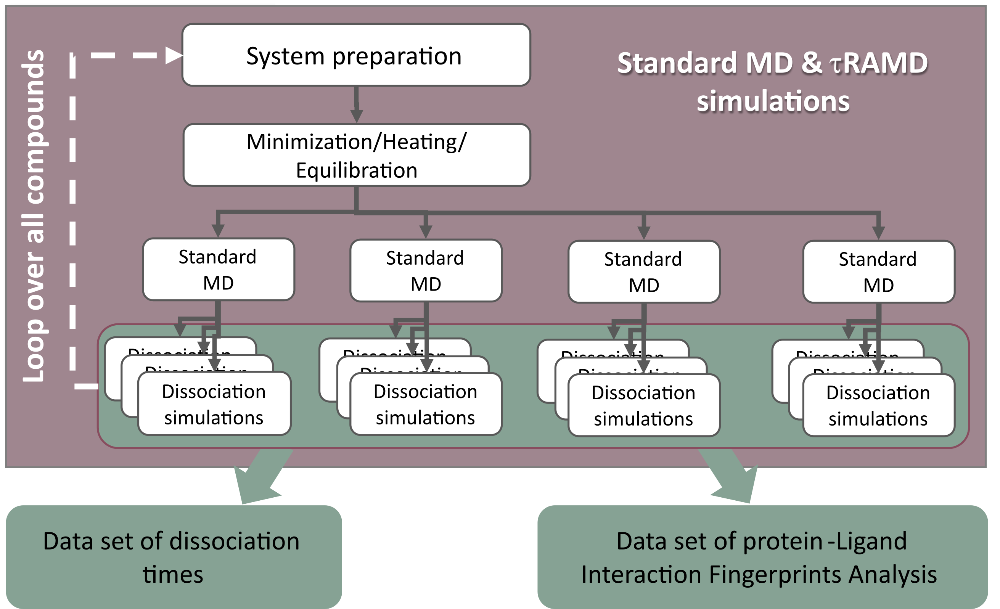


# **1. View input structures**

Let's first have a look at the 3D structure of the complex of interest using NGLviewer. 

The following cell creates a molecular viewer to visualise the structure of the iperoxo agonist (IXO) bound to the active conformation of mAChR M2 with the positive allosteric modulator (PAM) LY2119620 and a fused intracellular domain that stablizes the active conformation of the protein (**PDB ID: 4MQT**). The protein is shown as cartoon and the two ligands as licorice in cyan (IXO) and magenta (PAM). The ECL2 extracellular loop is colored in blue.

To visualize the other pdb files, modify, comment and uncomment the necessary lines as indicated in the cell below.

Alternatively, pdb files can also be visualized in Pymol after downloading.

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()
# View the downloaded structure
# Create a NGL widget object
#viewPDB=None
viewPDB = nglview.NGLWidget()
# Set the display size
viewPDB._remote_call('setSize', target='Widget', args=['600px','400px'])

# Define files to load
IXO_PAM_struct_file = nglview.FileStructure(os.path.join(pdbdir, '4MQT-IXO-PAM.pdb'))

# Create a component object for displaying the structure and clear the default representation
viewPDB_struct = viewPDB.add_component(IXO_PAM_struct_file, default_representation=False)

# Add customized representations
viewPDB_struct.add_cartoon(selection = "1-414", color_scheme='residueindex')
viewPDB_struct.add_licorice('IXO and (not hydrogen)', color='cyan',radius=0.5)   #this is valid also for 4QMT-ACh.pdb
viewPDB_struct.add_licorice('7050 and (not hydrogen)', color='magenta',radius=0.5)   #comment if you are visualizing 4MQT-IXO.pdb

# Display the widget
viewPDB.center('IXO')
viewPDB

NGLWidget()

In the following, the solvated and parameterized system is shown. In the simulations, the engineered construct of GPCR with the fused nanobody was retained. The system is embedded in a lipid bilayer (50% cholesterol, 30% POPC and 20% POPE to represent the main components of the synaptic membrane) and solvated with TIP3P water molecules, and Na+ and Cl- ions were added to reach neutrality at an ion concetration of 150mM.

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()

# View the downloaded structure
# Create a NGL widget object
viewBOX = nglview.NGLWidget()

# Set the display size
viewBOX._remote_call('setSize', target='Widget', args=['600px','400px'])

# Define files to load
IXO_struct_file = nglview.FileStructure(os.path.join(pdbdir, '4MQT-IXO.pdb'))

# Create a component object for displaying the structure and clear the default representation
viewBOX_struct = viewBOX.add_component(IXO_struct_file, default_representation=False)

# Add customized representations
viewBOX_struct.add_cartoon(selection = "1-414", color_scheme='residueindex')
viewBOX_struct.add_licorice('IXO and (not hydrogen)', color='cyan',radius=0.5)
viewBOX_struct.add_licorice('not protein and (not hydrogen)', opacity=0.7)
viewBOX_struct.add_spacefill('NA+', opacity=0.5)
viewBOX_struct.add_spacefill('CL-', opacity=0.5)

# Display the widget
viewBOX.center()
viewBOX

NGLWidget()

Having prepared the system, MD equilibrations and RAMD simulations are started as follows:

**1. Equilibration:**

	1.1 Run Gromacs equilibration: NVT simulations (Berendsen thermostat).

	1.2 Run Gromacs equilibration: from a single short NVT equilibration, 4 to 6 replicas are generated under NPT conditions (Nosé–Hoover thermostat and Parrinello-Rahman barostat).

  
**2. RAMD:**

	2.1 Run RAMD: From every equilibration replica, the corresponding *cpt file is used to run RAMD (performed under the same NPT conditions). From 10 to 15 trajectories are run for each replica.Gromacs/




Differently from the classic `.mdp` parameter file for conventional MD, the RAMD parameter file contains the following additional lines (see the [ramd github](https://github.com/HITS-MCM/gromacs-ramd) page for more information):

	ramd                     = yes
	ramd-seed                = 98XX
	ramd-force               = 585        ; 14 kcal/mol A
	ramd-eval-freq           = 50         ; number of steps in each RAMD cycle
	ramd-r-min-dist          = 0.0025     ; nm
	ramd-force-out-freq      = 100
	ramd-max-dist            = 7.0        ; nm
	ramd-receptor            = Protein
	ramd-ligand              = JTZ
	
From the list of parameters above, the `ramd-force` (magnitude of the random force applied) is the parameter the user should modify according to the system studied. The force constant is in kJ/mol/nm. A reasonable starting value is 585 kJ/mol nm = 14 kcal/mol Å. The upper threshold of the force magnitude is determined by the fast-dissociated compounds, whose dissociation time should be longer than about 100 ps. If it is shorter, the magnitude of the random force should be decreased. 

**Note: The magnitude of the random force should be kept constant over the set of protein-ligand complexes studied.**
 
After having generated a suitable amount of equilibration replicas and RAMD simulations, you will end up having a directory organization looking like:

	GROMACS/ #contains conventional MD equilibration trajectories 
		Replica1/ #contains the starting snapshot (*cpt file) for running RAMD simulations
		Replica2/
		Replica3/
		.....
 
	RAMD/
		Replica1 # contains the ~15 RAMD trajectories generated from Replica 1
			TRJ1-1/ 
			TRJ1-2/
			TRJ1-3/
			....



# **2. Compute residence time**

**In this section, the relative residence time will be computed by processing the set of RAMD simulations run per ligand.**



The working directory '**residencetime**' contains three sub-folders for each of the three systems under investigation (ACh-CHL, IXO-CHL and IXO-ALO). In each folder, a series of `.dat` files containing the egress times for each RAMD replica at different force magnitudes (ex=12 kcal mol−1 Å-1, sl=14 kcal mol−1 Å-1, fa=16 kcal mol−1 Å-1) are listed. These will be used to compute the relative residence times.

With the following cell, you are first requested to choose the force magnitude (`version`) and the ligand of interest (`ligand`). The IXO-CHL and force magnitude 12 kcal mol-1 Å-1 are selected for the analysis.


In [ ]:
# choose simulation type
simulation_type = {"f16_":"all_fa-","f14_":"all_sl-","f12_":"all_ex-","f10_":"all_su-",}

######################## Select the system to be analyzed
dir_all =  "/content/work/tauRAMDanalysis/residencetime/"

# Choose a system either mAChR M2 muscarinic receptor or β2AR - β2-adrenergic receptor 
M2 = True
AR = not M2
# choose data computed using a specific RAMD force 
version = "f12_" 
#########################

if M2: 
    # choose a ligand:   
    #   "IXO-ALO" - iperoxo with PAM
    #   "IXO-CHL" - iperoxo
    #   "ACh-CHL" - Ach
    ligand ="IXO-CHL" 
    name_template = simulation_type[version] #"*SL-700-RAMD*.pkl"  "*FA-700-RAMD*.pkl"
    DIR_out = dir_all+ligand
    os.chdir(DIR_out)
print(DIR_out)

/content/work/tauRAMDanalysis/residencetime/IXO-CHL


When the set maximum distance between the centers of mass of the protein and the ligand is reached, the Gromacs-ramd execution will be stopped and we will be ready to compute relative residence time. The RAMD output file generated in GROMACS will contain a line with the following format `“==== RAMD ==== GROMACS will be stopped after 6270900 steps”` stating the number of steps executed before dissociation. This line can be used to extract the dissociation time in
each trajectory. 

This is done through the execution of the tauRAMD-v2.py script which performs a bootstrapping using as input this set of lines collected in a `.dat` file for each replica (more details at [KBbox](https://kbbox.h-its.org/toolbox/tutorials/estimation-of-relative-residence-times-of-protein-ligand-complexes-using-random-acceleration-molecular-dynamics-ramd-implementation-in-gromacs/)).


***e.g.*, for a set of 15 RAMD simulations generated from the same snapshot (replica), the input .dat file is the collection of all the lines extracted from the `*out` files of each RAMD run and would look like this:**

	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 6270900 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 10044000 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 804400 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 10242100 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 1287450 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 11427450 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 16718000 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 9240100 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 4289300 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 11169000 steps.
	TRJ1/YYYY.out:==== RAMD ==== GROMACS will be stopped after 15840150 steps.


Together with the computation of residence time, a set of statistical analyses for the evaluation of the quality of the sampling will be performed as follows:

1.   At first, the cumulative distribution function (CDF) for a set of RAMD trajectories (with each trajectory
in a set starting from the same replica) is computed. The effective residence time for each starting replica is defined by the time when the ligand has dissociated half of the trajectories, corresponding to 50% of the CDF.

2.  A bootstrapping procedure (5000 rounds with 80% of
the samples selected randomly) of the raw data is performed to obtain a residence time for each replica, τ Repl, which should converge to a Gaussian-like distribution if the sampling is sufficiently large. Otherwise, the number of simulated trajectories for this replica should be increased.  

3. To assess the sampling quality, a Kolmogorov–Smirnov (KS) test is performed. The KS result is expressed by the distance between the Poisson cumulative distribution fucntion (PCDF) and the empirical cumulative density function (ECDF) obtained from the raw data. PCDF is defined as `𝑃 = 1 − exp(−𝑡/τrepl)` where `τrepl` values are the  ones computed from the bootstrapping  procedure  on  the  corresponding  subset  of trajectories. ECDF is obtained from the dissociation  probability  distribution observed in RAMD simulations.

  A small  KS value indicates that the measured distribution of the dissociation times is very similar to a Poisson distribution with a characteristic time τrepl. Typically, the KS value ranges between 0.1 and 0.2.

4.   Finally, a box plot of the relative residence times obtained from each replica will be produced and the final relative residence time of a ligand can be estimated as the mean residence time over all replicas. 

With the following cell, you will be able to execute the tauRAMD-v2.py script for the estimation of residence time from the set of RAMD trajectories run for IXO-CHL with a force magnitude of 12 kcal mol-1 Å-1 and reproduce **Fig. S1** from ([Kokh et al. 2021](https://pubs.acs.org/doi/10.1021/acs.jctc.1c00641)).

The output will display four plots:

(1) The cumulative residence time for the sets of RAMD trajectories generated from 5 replicas. The effective residence time is indicated by the red solid line.

(2) Distribution of effective residence times obtained after bootstrapping of the rawdata along with the corresponding Gaussian distribution (black line); the mean and the half-width of each distribution are indicated by red lines.

(3) Comparison of the Poisson cumulative distribution function (PCDF, black line) with the empirical cumulative density function (ECDF, blue points) obtained from the dissociation probability distribution.The residence time for each replica is indicated by the red line; the results of the Kolmogorov-Smirnov (KS) test are quantified by the supremum of the distance D between the Poisson and empirical CDFs (denoted above the plot); 

(4) Boxplots of the relative residence times obtained for each replica. The box extends from the lower totheupper quartile values of the data, the whiskers show the range of the data, outliers are shown by black circles, the median and mean are shown by orange and dashed red lines, respectively. The average residence time in ns computed from all replicas is shown with its standard deviation above the box plot.





Data found: all_ex-1.dat
Data found: all_ex-2.dat
Data found: all_ex-3.dat
Data found: all_ex-4.dat
Data found: all_ex-5.dat
************ Dissociation times for all_ex-1.dat ****************
[33.1101 13.3654 28.3827  6.8054  2.1132 21.2031 18.4104 11.1253 17.2759
  8.6225]
************ Dissociation times for all_ex-2.dat ****************
[21.0384  4.5988 16.7693  8.1565  3.7007 27.1037  8.2111 18.075  39.5803
 31.6783 22.3055 18.0051]
************ Dissociation times for all_ex-3.dat ****************
[20.76   49.37    4.4274 37.3532 20.0032 32.0751 30.21   47.315  41.015
 39.07   28.892   4.3134 29.09   31.005 ]
************ Dissociation times for all_ex-4.dat ****************
[ 4.8682 30.2613  1.5571  6.443  18.8818  8.2516  3.2578 30.9349  3.7655
 14.8023 26.0665  1.5897]
************ Dissociation times for all_ex-5.dat ****************
[15.3698 12.28   12.49    5.6    30.55   42.755   2.88    5.315   8.54
  5.9329  6.4546 39.2301]

 ==============   Bootstrapping and computation of t

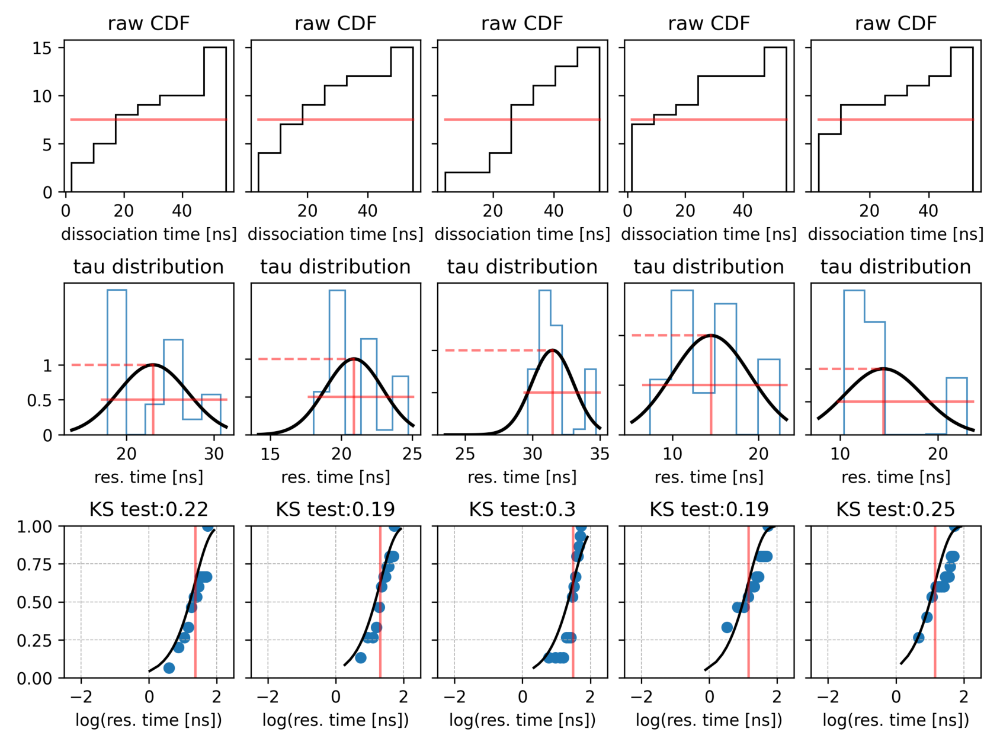

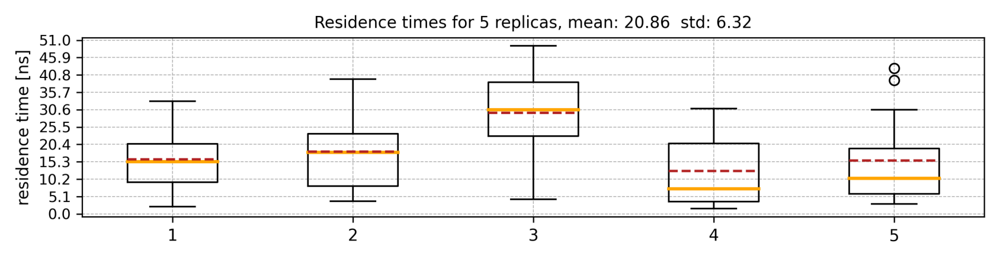

In [ ]:
!python ../tauRAMD-v2.py all_ex-1.dat all_ex-2.dat all_ex-3.dat all_ex-4.dat all_ex-5.dat
plt.rcParams.update({'figure.figsize': (30,30)})
res_time = mpimg.imread('res_times.png')
res_time_summary = mpimg.imread('res_times_summary.png')
print("=========RESIDENCE TIME ESTIMATION AND STATISTICS=========")
imgplot = plt.imshow(res_time)
plt.axis('off')
plt.show()
imgplot_summary = plt.imshow(res_time_summary)
plt.axis('off')
plt.show()

# **2. Plotting relative residence times (using pre-computed values) versus experimental ones**

In this section, the previously computed residence time will be compared with the experimental residence times at the three random force magnitudes.

In the generated plot, the darkness of the color
decreases with increasing random force magnitude from 12 kcal mol−1 Å−1 to 14 kcal mol−1 Å−1 to 16 kcal mol−1 Å−1 with dashed lines showing linear fits of the computed values to the experimental ones.

The relative values computed for the different systems show a good linear correlation on a logarithmic scale with the experimental residence time for all forces applied (R2 = 0.97, 0.97, and 0.89 and the mean standard deviation for computed residence times is 22%, 23%, and 37% for the random force magnitudes of 12, 14, and 16 kcal mol−1 Å−1
, respectively).

>>>>>>>>>>>>>>>> [8.10810811e-01 9.67741935e+01 3.75000000e+03]
=========================== F12 =====================
1.4187604748839848 times
2.241542205388462 times
1.5799299776600706 times
R2_12  0.9732895509490402 1.7467442193108393
F12 SD  >>>>>>>>>>>.. 22 %
=========================== F14 =====================
1.4574454461945614 times
2.3851036197753306 times
1.6364959841226947 times
R2_14  0.9691545953413712 1.8263483500308622
F14 SD  >>>>>>>>>>>.. 23 %
=========================== F16 =====================
2.0688117169708353 times
5.352551737151649 times
2.587259001504912 times
R2_16  0.8940196020316035 [1.        0.9455261] 3.336207485209132
F16 SD  >>>>>>>>>>>.. 37 %


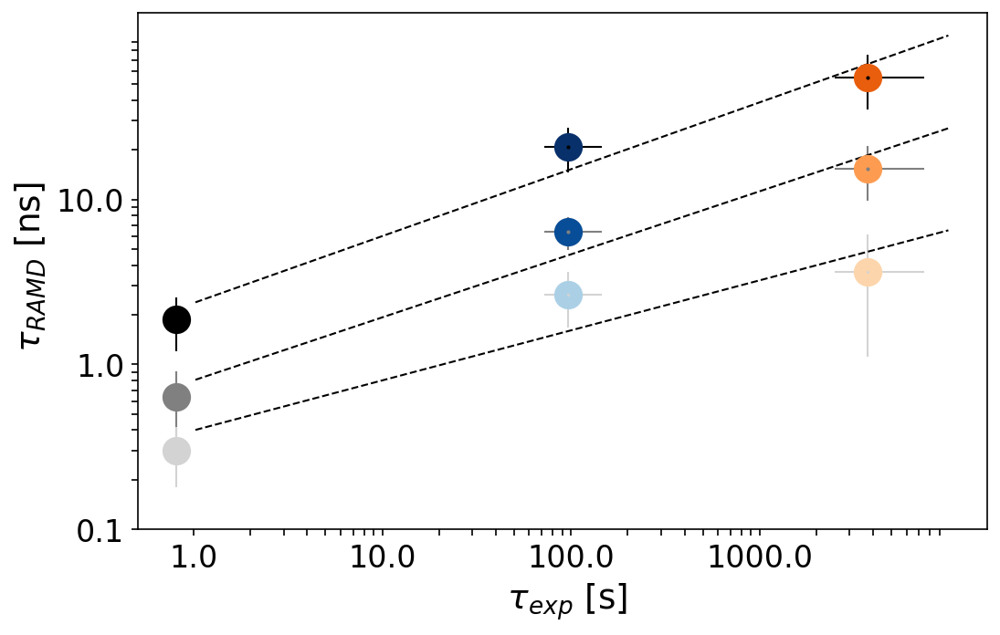

In [ ]:
from sklearn.metrics import r2_score
def mue_pred(x_list,y_list,a,b):
    mu = 0
    for x,y in zip(x_list,y_list):
        d = np.abs((y-b)/a - x)
        mu += max(pow(10,x+d)/pow(10,x),pow(10,x-d)/pow(10,x))
        print(max(pow(10,x+d)/pow(10,x),pow(10,x-d)/pow(10,x)),"times")
    return(mu/np.shape(x_list)[0])
        
top = cm.get_cmap('Oranges_r', 10)
bottom = cm.get_cmap('Blues', 10)
pallet1 = np.vstack((top(np.linspace(0, 1, 10)), bottom(np.linspace(0, 1, 10))))
top = cm.get_cmap('Oranges_r', 10)
bottom = cm.get_cmap('Greens', 10)
pallet2 = np.vstack((top(np.linspace(0, 1, 10)), bottom(np.linspace(0, 1, 10))))

N = ["ACh-M2","IXO-M2","IXO & LY2119620- M2"]
exp_orig = np.asarray( [74,0.62, 0.016])/60.
exp_err_ori = np.asarray( [0.1, 0.21, 0.0079])/60.
#exp_err_p =  np.log10(1/(exp_orig + exp_err_ori))-exp
#exp_err_m = exp-np.log10(1/(exp_orig - exp_err_ori))

#exp_err = 1/(exp_orig * np.log(10)) * exp_err
exp = np.log10(1/exp_orig)

exp_err_m =  1.0/(exp_orig + exp_err_ori)
exp_err_p = 1.0/(exp_orig - exp_err_ori)
exp_err_m =  exp-np.log10(exp_err_m)
exp_err_p = np.log10(exp_err_p)-exp
exp_err_p[np.isinf(exp_err_p)] = 0
print(">>>>>>>>>>>>>>>>",1/exp_orig)

tau16 = np.array([0.30, 2.65, 3.62])
tau14 = np.array([0.64, 6.4, 15.38])
tau12 = np.array([1.88, 20.86, 55])

tau16_sd = np.array([0.12, 0.98, 2.5])
tau14_sd = np.array([0.27, 1.45, 5.6])
tau12_sd = np.array([0.68, 6.3, 20])

e = np.array([0.01,0.1,1,2,3,4])

fig, ax = plt.subplots(figsize = (8, 5),dpi=150)


data = []
data.append((np.array(tau12),np.array(tau12_sd),np.array(N)))
data_err_p = (np.log10(np.array(tau12)+np.array(tau12_sd)))- np.log10(np.array(tau12))
data_err_m =  np.log10(np.array(tau12)) -(np.log10(np.array(tau12)-np.array(tau12_sd)))

color=['k',pallet1[19],pallet1[3],pallet2[19]]
print("=========================== F12 =====================")

for i in range (0,len(exp)):
    if data[0][0][i] > 0:
       # print(exp[i],data[0][0][i],data_err_m[i],data_err_p[i])
        plt.errorbar(x=exp[i], y=np.log10(np.array(tau12))[i], color=color[i],lw = 1,\
             marker = "o",ms=13,ls='none',label=N[i],mew=2)
plt.errorbar(x=exp, y=np.log10(np.array(tau12)),  yerr=[data_err_m,data_err_p], xerr=[exp_err_m,exp_err_p],lw = 1,marker = "o",ms=1,ls='none', c='k')

s = np.polyfit(exp[tau12> 0],np.log10(data[0][0][tau12> 0]),1)
r2 = r2_score(np.log10(data[0][0][tau12> 0]),s[0]*exp[tau12> 0]+s[1])        
print("R2_12 ",r2,mue_pred(exp,np.log10(data[0][0]),s[0],s[1]))
plt.plot(e, s[0]*e+s[1],lw=1,color='k',ls = '--')
#plt.legend(fontsize=12) 

err = 0
for i in range (0,len(exp)):
    err += np.abs(tau12[i] -pow(10,s[0]*exp[i]+s[1]))/pow(10,s[0]*exp[i]+s[1])
err = int(100*err/len(exp))
print("F12 SD  >>>>>>>>>>>..",err,"%")

print("=========================== F14 =====================")
data = []
data.append((np.array(tau14),np.array(tau14_sd),np.array(N)))
data_err_p = (np.log10(np.array(tau14)+np.array(tau14_sd)))- np.log10(np.array(tau14))
data_err_m =  np.log10(np.array(tau14)) -(np.log10(np.array(tau14)-np.array(tau14_sd)))

color=['gray',pallet1[18],pallet1[5],pallet2[16]]

for i in range (0,len(exp)):
    if data[0][0][i] > 0:
      #  print(exp[i],data[0][0][i],data_err_m[i],data_err_p[i])
        plt.errorbar(x=exp[i], y=np.log10(np.array(tau14))[i], color=color[i],lw = 1,\
             marker = "o",ms=13,ls='none',label=N[i],mew=2)
plt.errorbar(x=exp, y=np.log10(np.array(tau14)),  yerr=[data_err_m,data_err_p], xerr=[exp_err_m,exp_err_p],lw = 1,marker = "o",ms=1,ls='none', c='gray')

s = np.polyfit(exp[tau12> 0],np.log10(data[0][0][tau12> 0]),1)
r2 = r2_score(np.log10(data[0][0][tau12> 0]),s[0]*exp[tau12> 0]+s[1])        
print("R2_14 ",r2,mue_pred(exp,np.log10(data[0][0]),s[0],s[1]))
plt.plot(e, s[0]*e+s[1],lw=1,color='k',ls = '--')

err = 0
for i in range (0,len(exp)):
    err += np.abs(tau14[i] -pow(10,s[0]*exp[i]+s[1]))/pow(10,s[0]*exp[i]+s[1])
err = int(100*err/len(exp))
print("F14 SD  >>>>>>>>>>>..",err,"%")
print("=========================== F16 =====================")

data = []
data.append((np.array(tau16),np.array(tau16_sd),np.array(N)))
data_err_p = (np.log10(np.array(tau16)+np.array(tau16_sd)))- np.log10(np.array(tau16))
data_err_m =  np.log10(np.array(tau16)) -(np.log10(np.array(tau16)-np.array(tau16_sd)))

color=['lightgray',pallet1[13],pallet1[7],pallet2[13]]

for i in range (0,len(exp)):
    if data[0][0][i] > 0:
        plt.errorbar(x=exp[i], y=np.log10(data[0][0][i]),  color=color[i],lw = 1,\
             marker = "o",ms=13,ls='none',label=N[i],mew=2)
plt.errorbar(x=exp, y=np.log10(np.array(tau16)),  yerr=[data_err_m,data_err_p], xerr=[exp_err_m,exp_err_p],lw = 1,marker = "o",ms=0.5,ls='none', c='lightgray')

s = np.polyfit(exp[tau16> 0],np.log10(data[0][0][tau16> 0]),1)
r2 = r2_score(np.log10(data[0][0][tau16> 0]),s[0]*exp[tau16> 0]+s[1])        
print("R2_16 ",r2,np.corrcoef(exp[tau16> 0],np.log10(data[0][0][tau16> 0]))[0],mue_pred(exp,np.log10(data[0][0]),s[0],s[1]))
plt.plot(e, s[0]*e+s[1],lw=1,color='k',ls = '--')

err = 0
for i in range (0,len(exp)):
    err += np.abs(tau16[i] -pow(10,s[0]*exp[i]+s[1]))/pow(10,s[0]*exp[i]+s[1])
err = int(100*err/len(exp))
print("F16 SD  >>>>>>>>>>>..",err,"%")

y_tick_lable = []
y_tick_pos = []
for k in range(0,3):
    for ii,i in enumerate(range(pow(10,k),pow(10,k+1),pow(10,k))):            
        if(ii == 0): y_tick_lable.append(str(i/10.))
        else: y_tick_lable.append("")
        y_tick_pos.append(np.log10(i/10.))
x_tick_lable = []
x_tick_pos = []
for k in range(0,4):
    for ii,i in enumerate(range(pow(10,k),pow(10,k+1),pow(10,k))):            
        if(ii == 0): x_tick_lable.append(str(i/1))
        else: x_tick_lable.append("")
        x_tick_pos.append(np.log10(i))

plt.ylabel(r' $\tau_{RAMD} $ [ns]',fontsize=18)
plt.xlabel(r' $\tau_{exp} $ [s]',fontsize=18)
#plt.xticks(range(1,len(N)+1), N,fontsize=14)
plt.yticks(y_tick_pos,y_tick_lable, fontsize=16)
plt.xticks(x_tick_pos,x_tick_lable, fontsize=16)
#for i,n in enumerate(N):
#    plt.text(exp[i]+0.05, np.log10(data[0][0])[i],n,fontsize=16)
    
s = np.polyfit(exp,np.log10(data[0][0]),1)

plt.show()